In [1]:
import pandas as pd
import matplotlib.pyplot as plt


# Explatory Data Analysis on the Enviromental Sensor  Data 

In [2]:
dfe = pd.read_csv('Data_set/stuard_environmental_data.csv')

In [3]:
dfe.head()

,id,device_identifier,ts_generation,co2,humidity,pressure,temperature,battery
0,31938,abc0d16aaf15b3a4ee2e561195dfd82ab260497412e326...,1688019286484,635,61.0,1010.7,24.5,NaN
1,32234,abc0d16aaf15b3a4ee2e561195dfd82ab260497412e326...,1688043749456,472,39.5,1010.9,41.2,100.0
2,32243,abc0d16aaf15b3a4ee2e561195dfd82ab260497412e326...,1688044308221,467,46.0,1010.8,40.2,NaN
3,32254,abc0d16aaf15b3a4ee2e561195dfd82ab260497412e326...,1688044908191,463,38.0,1010.6,39.7,NaN
4,32264,abc0d16aaf15b3a4ee2e561195dfd82ab260497412e326...,1688045508203,436,35.0,1010.6,39.4,NaN


In [4]:
dfe.shape

(10964, 8)

In [5]:
dfe.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10964 entries, 0 to 10963
Data columns (total 8 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   id                 10964 non-null  int64  
 1   device_identifier  10964 non-null  object 
 2   ts_generation      10964 non-null  int64  
 3   co2                10964 non-null  int64  
 4   humidity           10964 non-null  float64
 5   pressure           10964 non-null  float64
 6   temperature        10964 non-null  float64
 7   battery            75 non-null     float64
dtypes: float64(4), int64(3), object(1)
memory usage: 685.4+ KB


In [6]:
dfe.isnull().sum()

id                       0
device_identifier        0
ts_generation            0
co2                      0
humidity                 0
pressure                 0
temperature              0
battery              10889
dtype: int64

In [7]:
dfe['temperature'].unique()

array([24.5, 41.2, 40.2, 39.7, 39.4, 39.8, 38.7, 40.6, 35.9, 34.9, 34.7,
       34.2, 33.6, 33.8, 34.5, 34.6, 33.9, 34. , 33.2, 33.1, 32.7, 31.7,
       30.7, 29.3, 28.4, 27.8, 27.7, 27.3, 27. , 26.4, 26.1, 25.8, 25.4,
       25. , 25.2, 25.3, 25.1, 24.7, 24.1, 23.4, 23.3, 23.7, 23.9, 23.2,
       23. , 22.9, 23.1, 22.8, 22.6, 22.5, 22.7, 22.4, 22.2, 21.8, 21. ,
       20.5, 20.2, 20.1, 19.9, 19.8, 19.6, 19.7, 19.4, 19.1, 18.8, 18.6,
       18.4, 18.3, 18.9, 19.3, 20. , 20.3, 21.2, 23.5, 23.8, 27.5, 26.2,
       26.7, 27.6, 26.8, 26.3, 25.9, 26. , 24.8, 24.3, 23.6, 22.1, 21.6,
       21.5, 20.7, 20.6, 19.5, 19. , 19.2, 18.7, 18.5, 18.1, 17.9, 18. ,
       17.8, 17.6, 17.3, 17.1, 17. , 17.2, 16.9, 17.5, 17.7, 18.2, 21.9,
       25.7, 27.4, 28.1, 26.6, 27.1, 27.9, 28.9, 29.7, 29.4, 29.2, 30.1,
       29. , 29.6, 30.3, 30.5, 30.8, 32. , 32.1, 32.5, 31.2, 31.8, 32.4,
       32.9, 32.8, 33. , 31.1, 32.2, 31.4, 30.9, 21.4, 20.4, 17.4, 27.2,
       28.5, 30. , 31.6, 32.3, 32.6, 33.5, 34.4, 34

#### now let's chage the time stamp to data and time for further analysis

In [8]:
dfe['DateTime']=pd.to_datetime(dfe['ts_generation'], unit='ms')

In [9]:
dfe.head()

,id,device_identifier,ts_generation,co2,humidity,pressure,temperature,battery,DateTime
0,31938,abc0d16aaf15b3a4ee2e561195dfd82ab260497412e326...,1688019286484,635,61.0,1010.7,24.5,NaN,2023-06-29 06:14:46.484
1,32234,abc0d16aaf15b3a4ee2e561195dfd82ab260497412e326...,1688043749456,472,39.5,1010.9,41.2,100.0,2023-06-29 13:02:29.456
2,32243,abc0d16aaf15b3a4ee2e561195dfd82ab260497412e326...,1688044308221,467,46.0,1010.8,40.2,NaN,2023-06-29 13:11:48.221
3,32254,abc0d16aaf15b3a4ee2e561195dfd82ab260497412e326...,1688044908191,463,38.0,1010.6,39.7,NaN,2023-06-29 13:21:48.191
4,32264,abc0d16aaf15b3a4ee2e561195dfd82ab260497412e326...,1688045508203,436,35.0,1010.6,39.4,NaN,2023-06-29 13:31:48.203


In [10]:
dfe['device_identifier'].unique()

array(['abc0d16aaf15b3a4ee2e561195dfd82ab260497412e326bb57f2ee5bbe9042d8'],
      dtype=object)

#### since our device name is only one let's change the name to EM500-CO2 for now, but infact all value contains one unique value its not important but let's keep it for now if we want we can drop it, and drop the ts_genration since already we convert it to time and date 

In [11]:
dfe['device_identifier']= 'EM500 Co2'

In [12]:
dfe.drop(columns=['ts_generation'], inplace=True)

In [13]:
dfe.head(10)

,id,device_identifier,co2,humidity,pressure,temperature,battery,DateTime
0,31938,EM500 Co2,635,61.0,1010.7,24.5,NaN,2023-06-29 06:14:46.484
1,32234,EM500 Co2,472,39.5,1010.9,41.2,100.0,2023-06-29 13:02:29.456
2,32243,EM500 Co2,467,46.0,1010.8,40.2,NaN,2023-06-29 13:11:48.221
3,32254,EM500 Co2,463,38.0,1010.6,39.7,NaN,2023-06-29 13:21:48.191
4,32264,EM500 Co2,436,35.0,1010.6,39.4,NaN,2023-06-29 13:31:48.203
5,32274,EM500 Co2,427,33.0,1010.3,39.8,NaN,2023-06-29 13:41:48.167
6,32284,EM500 Co2,450,32.5,1010.1,38.7,NaN,2023-06-29 13:51:48.148
7,32297,EM500 Co2,472,30.0,1010.1,40.6,NaN,2023-06-29 14:01:48.111
8,32307,EM500 Co2,442,31.5,1010.0,35.9,NaN,2023-06-29 14:11:48.086
9,32316,EM500 Co2,442,35.0,1009.9,34.9,NaN,2023-06-29 14:21:47.727


In [110]:
dfe.head()

,id,DateTime,device_identifier,co2,humidity,pressure,temperature,battery
0,31938,2023-06-29 06:14:46.484,EM500 Co2,635,61.0,1010.7,24.5,NaN
1,32234,2023-06-29 13:02:29.456,EM500 Co2,472,39.5,1010.9,41.2,100.0
2,32243,2023-06-29 13:11:48.221,EM500 Co2,467,46.0,1010.8,40.2,NaN
3,32254,2023-06-29 13:21:48.191,EM500 Co2,463,38.0,1010.6,39.7,NaN
4,32264,2023-06-29 13:31:48.203,EM500 Co2,436,35.0,1010.6,39.4,NaN


In [111]:
dfe.rename(columns={"device_identifier":"Sensor_Name(Identifier)"}, inplace=True)

In [112]:
dfe.rename(columns={"co2":"co2(ppm)"}, inplace=True)

In [113]:
dfe.rename(columns={"humidity":"humidity(%RH)"}, inplace=True)

In [114]:
dfe.rename(columns={"pressure":"barometric_pressure(hPa)"}, inplace=True)

In [115]:
dfe.rename(columns={"temperature":"Temperature [°C]"}, inplace=True)

In [116]:
dfe.rename(columns={"battery":"battery [%]"}, inplace=True)

In [117]:
dfe.head()

,id,DateTime,Sensor_Name(Identifier),co2(ppm),humidity(%RH),barometric_pressure(hPa),Temperature [°C],battery [%]
0,31938,2023-06-29 06:14:46.484,EM500 Co2,635,61.0,1010.7,24.5,NaN
1,32234,2023-06-29 13:02:29.456,EM500 Co2,472,39.5,1010.9,41.2,100.0
2,32243,2023-06-29 13:11:48.221,EM500 Co2,467,46.0,1010.8,40.2,NaN
3,32254,2023-06-29 13:21:48.191,EM500 Co2,463,38.0,1010.6,39.7,NaN
4,32264,2023-06-29 13:31:48.203,EM500 Co2,436,35.0,1010.6,39.4,NaN


In [119]:
dfe.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10964 entries, 0 to 10963
Data columns (total 8 columns):
 #   Column                    Non-Null Count  Dtype         
---  ------                    --------------  -----         
 0   id                        10964 non-null  int64         
 1   DateTime                  10964 non-null  datetime64[ns]
 2   Sensor_Name(Identifier)   10964 non-null  object        
 3   co2(ppm)                  10964 non-null  int64         
 4   humidity(%RH)             10964 non-null  float64       
 5   barometric_pressure(hPa)  10964 non-null  float64       
 6   Temperature [°C]          10964 non-null  float64       
 7   battery [%]               75 non-null     float64       
dtypes: datetime64[ns](1), float64(4), int64(2), object(1)
memory usage: 685.4+ KB


In [120]:
### Now let's save out clean_data if e want further processing we will start from there
dfe.to_csv('Enviromental_data_intial_clean.csv', index=False)

### lNow lets  import the Next   dataset (Soil sensor data )and analyse them

In [15]:
df_soil=pd.read_csv('Data_set/stuard_soil_data.csv')

In [16]:
df_soil.shape

(32668, 8)

In [17]:
df_soil.head()

,id,ts_generation,device_identifier,line,electrical_conductivity,humidity,temperature,battery
0,32299,1688047456101,9d5fe860849cee394ff52cd69a6d69642ea9f4756dac17...,2,723,31.9,29.1,NaN
1,32309,1688048057491,9d5fe860849cee394ff52cd69a6d69642ea9f4756dac17...,2,723,31.9,29,NaN
2,32319,1688048658856,9d5fe860849cee394ff52cd69a6d69642ea9f4756dac17...,2,723,31.74,29,NaN
3,32329,1688049260229,9d5fe860849cee394ff52cd69a6d69642ea9f4756dac17...,2,722,31.74,29,NaN
4,32348,1688050462965,9d5fe860849cee394ff52cd69a6d69642ea9f4756dac17...,2,723,31.61,28.9,NaN


#### here let's do some data cleaning change the date since humidity is also in the enviroment let's change the column name

In [18]:
df_soil.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32668 entries, 0 to 32667
Data columns (total 8 columns):
 #   Column                   Non-Null Count  Dtype 
---  ------                   --------------  ----- 
 0   id                       32668 non-null  object
 1   ts_generation            32668 non-null  object
 2   device_identifier        32668 non-null  object
 3   line                     32668 non-null  object
 4   electrical_conductivity  32668 non-null  object
 5   humidity                 32668 non-null  object
 6   temperature              32668 non-null  object
 7   battery                  228 non-null    object
dtypes: object(8)
memory usage: 2.0+ MB


In [19]:
#### here one problem is as we see above ts_generation is not int like above envirometal sensor data so let's see it alone

In [20]:
df_soil['ts_generation'].head(100)

0     1688047456101
1     1688048057491
2     1688048658856
3     1688049260229
4     1688050462965
          ...      
95    1688105186945
96    1688105788334
97    1688106389693
98    1688106991041
99    1688107592397
Name: ts_generation, Length: 100, dtype: object

In [21]:
df_soil.notna().sum()

id                         32668
ts_generation              32668
device_identifier          32668
line                       32668
electrical_conductivity    32668
humidity                   32668
temperature                32668
battery                      228
dtype: int64

In [22]:
print(df_soil['ts_generation'].dtype)


object


In [23]:
#  Create the numeric-converted column with NaNs for invalid entries because the data type is not int so we can't convert to data and time like above easily
df_soil['ts_generation_numeric'] = pd.to_numeric(df_soil['ts_generation'], errors='coerce')

In [24]:
#  Filter rows where conversion failed (NaN values in the new column)
nan_rows = df_soil[df_soil['ts_generation_numeric'].isna()]

In [25]:
print(df_soil['ts_generation'].dtype)


object


In [26]:
# Show the rows with the original 'ts_generation' value and index
print(nan_rows[['ts_generation']])

       ts_generation
10862  ts_generation
21701  ts_generation


In [29]:
# if we wanna to display all the rows and columns in the data frame we can excute this code
pd.set_option('display.max_rows', None)

# Show all columns
pd.set_option('display.max_columns', None)

In [57]:
df_soil

,id,ts_generation,device_identifier,line,electrical_conductivity,humidity,temperature,battery,ts_generation_numeric
0,32299,1688047456101,9d5fe860849cee394ff52cd69a6d69642ea9f4756dac17...,2,723,31.9,29.1,NaN,1.688047e+12
1,32309,1688048057491,9d5fe860849cee394ff52cd69a6d69642ea9f4756dac17...,2,723,31.9,29,NaN,1.688048e+12
2,32319,1688048658856,9d5fe860849cee394ff52cd69a6d69642ea9f4756dac17...,2,723,31.74,29,NaN,1.688049e+12
3,32329,1688049260229,9d5fe860849cee394ff52cd69a6d69642ea9f4756dac17...,2,722,31.74,29,NaN,1.688049e+12
4,32348,1688050462965,9d5fe860849cee394ff52cd69a6d69642ea9f4756dac17...,2,723,31.61,28.9,NaN,1.688050e+12
5,32358,1688051064328,9d5fe860849cee394ff52cd69a6d69642ea9f4756dac17...,2,720,31.55,28.8,NaN,1.688051e+12
6,32368,1688051665689,9d5fe860849cee394ff52cd69a6d69642ea9f4756dac17...,2,720,31.48,28.8,NaN,1.688052e+12
7,32378,1688052267071,9d5fe860849cee394ff52cd69a6d69642ea9f4756dac17...,2,721,31.48,28.7,NaN,1.688052e+12
8,32390,1688052868426,9d5fe860849cee394ff52cd69a6d69642ea9f4756dac17...,2,722,31.41,28.7,NaN,1.688053e+12
9,32401,1688053469799,9d5fe860849cee394ff52cd69a6d69642ea9f4756dac17...,2,722,31.41,28.7,NaN,1.688053e+12


In [59]:
#### let try to drop the row with index 21701 which contains the object

In [27]:
df_soil=df_soil.drop(21701)

In [28]:
df_soil.shape

(32667, 9)

In [29]:
df_soil.iloc[10862]

id                                              id
ts_generation                        ts_generation
device_identifier                device_identifier
line                                          line
electrical_conductivity    electrical_conductivity
humidity                                  humidity
temperature                            temperature
battery                                    battery
ts_generation_numeric                          NaN
Name: 10862, dtype: object

In [30]:
#### let try to drop the row with index 10862 which contains the object as well

In [31]:
df_soil=df_soil.drop(10862)

In [32]:
df_soil.drop(columns=['ts_generation_numeric'])

,id,ts_generation,device_identifier,line,electrical_conductivity,humidity,temperature,battery
0,32299,1688047456101,9d5fe860849cee394ff52cd69a6d69642ea9f4756dac17...,2,723,31.9,29.1,NaN
1,32309,1688048057491,9d5fe860849cee394ff52cd69a6d69642ea9f4756dac17...,2,723,31.9,29,NaN
2,32319,1688048658856,9d5fe860849cee394ff52cd69a6d69642ea9f4756dac17...,2,723,31.74,29,NaN
3,32329,1688049260229,9d5fe860849cee394ff52cd69a6d69642ea9f4756dac17...,2,722,31.74,29,NaN
4,32348,1688050462965,9d5fe860849cee394ff52cd69a6d69642ea9f4756dac17...,2,723,31.61,28.9,NaN
...,...,...,...,...,...,...,...,...
32663,210003,1694639939977,91738f0250e567c5c673d2217596991d2eec0cc6da56ca...,1,139,23.29,23.4,NaN
32664,210020,1694640541323,91738f0250e567c5c673d2217596991d2eec0cc6da56ca...,1,139,23.29,23.4,NaN
32665,210036,1694641142688,91738f0250e567c5c673d2217596991d2eec0cc6da56ca...,1,139,23.29,23.4,NaN
32666,210055,1694641744068,91738f0250e567c5c673d2217596991d2eec0cc6da56ca...,1,139,23.29,23.4,NaN


In [33]:
df_soil.head()

,id,ts_generation,device_identifier,line,electrical_conductivity,humidity,temperature,battery,ts_generation_numeric
0,32299,1688047456101,9d5fe860849cee394ff52cd69a6d69642ea9f4756dac17...,2,723,31.9,29.1,NaN,1.688047e+12
1,32309,1688048057491,9d5fe860849cee394ff52cd69a6d69642ea9f4756dac17...,2,723,31.9,29,NaN,1.688048e+12
2,32319,1688048658856,9d5fe860849cee394ff52cd69a6d69642ea9f4756dac17...,2,723,31.74,29,NaN,1.688049e+12
3,32329,1688049260229,9d5fe860849cee394ff52cd69a6d69642ea9f4756dac17...,2,722,31.74,29,NaN,1.688049e+12
4,32348,1688050462965,9d5fe860849cee394ff52cd69a6d69642ea9f4756dac17...,2,723,31.61,28.9,NaN,1.688050e+12


In [34]:
df_soil.drop(columns=['ts_generation_numeric'], inplace=True)

In [35]:
df_soil.head()

,id,ts_generation,device_identifier,line,electrical_conductivity,humidity,temperature,battery
0,32299,1688047456101,9d5fe860849cee394ff52cd69a6d69642ea9f4756dac17...,2,723,31.9,29.1,NaN
1,32309,1688048057491,9d5fe860849cee394ff52cd69a6d69642ea9f4756dac17...,2,723,31.9,29,NaN
2,32319,1688048658856,9d5fe860849cee394ff52cd69a6d69642ea9f4756dac17...,2,723,31.74,29,NaN
3,32329,1688049260229,9d5fe860849cee394ff52cd69a6d69642ea9f4756dac17...,2,722,31.74,29,NaN
4,32348,1688050462965,9d5fe860849cee394ff52cd69a6d69642ea9f4756dac17...,2,723,31.61,28.9,NaN


In [36]:
df_soil['device_identifier'].value_counts()

device_identifier
91738f0250e567c5c673d2217596991d2eec0cc6da56ca2b83821cfea5ba5349    10966
9d5fe860849cee394ff52cd69a6d69642ea9f4756dac178e8ac998373f88563d    10862
0fa420b6626076658c3c1763550aee8149c2be5dba876a84a1ebd24aeaa84a78    10838
Name: count, dtype: int64

In [37]:
### here as we see there are 3 sensors for the soil data set so let's change their name for easy analysis
## like to use easily so EM500_SMTC_1, EM500_SMTC_2 AND EM500_3

In [38]:
device_map = {
    '91738f0250e567c5c673d2217596991d2eec0cc6da56ca2b83821cfea5ba5349': 'EM500_SMTC_1',
    '9d5fe860849cee394ff52cd69a6d69642ea9f4756dac178e8ac998373f88563d': 'EM500_SMTC_2',
    '0fa420b6626076658c3c1763550aee8149c2be5dba876a84a1ebd24aeaa84a78': 'EM500_SMTC_3'
}

In [39]:
df_soil['device_identifier'] = df_soil['device_identifier'].map(device_map)

In [40]:
df_soil.tail()

,id,ts_generation,device_identifier,line,electrical_conductivity,humidity,temperature,battery
32663,210003,1694639939977,EM500_SMTC_1,1,139,23.29,23.4,NaN
32664,210020,1694640541323,EM500_SMTC_1,1,139,23.29,23.4,NaN
32665,210036,1694641142688,EM500_SMTC_1,1,139,23.29,23.4,NaN
32666,210055,1694641744068,EM500_SMTC_1,1,139,23.29,23.4,NaN
32667,210072,1694642345445,EM500_SMTC_1,1,139,23.29,23.4,NaN


In [41]:
df_soil.info();

<class 'pandas.core.frame.DataFrame'>
Index: 32666 entries, 0 to 32667
Data columns (total 8 columns):
 #   Column                   Non-Null Count  Dtype 
---  ------                   --------------  ----- 
 0   id                       32666 non-null  object
 1   ts_generation            32666 non-null  object
 2   device_identifier        32666 non-null  object
 3   line                     32666 non-null  object
 4   electrical_conductivity  32666 non-null  object
 5   humidity                 32666 non-null  object
 6   temperature              32666 non-null  object
 7   battery                  226 non-null    object
dtypes: object(8)
memory usage: 2.2+ MB


In [42]:
df_soil.rename(columns={'device_identifier': 'sensor_name'}, inplace=True)

In [43]:
df_soil['ts_generation'] = df_soil['ts_generation'].astype('int64')

In [44]:
df_soil['DateTime'] = pd.to_datetime(df_soil['ts_generation'], unit='ms')

In [45]:
df_soil.head()

,id,ts_generation,sensor_name,line,electrical_conductivity,humidity,temperature,battery,DateTime
0,32299,1688047456101,EM500_SMTC_2,2,723,31.9,29.1,NaN,2023-06-29 14:04:16.101
1,32309,1688048057491,EM500_SMTC_2,2,723,31.9,29,NaN,2023-06-29 14:14:17.491
2,32319,1688048658856,EM500_SMTC_2,2,723,31.74,29,NaN,2023-06-29 14:24:18.856
3,32329,1688049260229,EM500_SMTC_2,2,722,31.74,29,NaN,2023-06-29 14:34:20.229
4,32348,1688050462965,EM500_SMTC_2,2,723,31.61,28.9,NaN,2023-06-29 14:54:22.965


In [46]:
### now we can drop the ts_generation column

In [47]:
df_soil.drop(columns=['ts_generation'], inplace=True)

In [48]:
df_soil.head()

,id,sensor_name,line,electrical_conductivity,humidity,temperature,battery,DateTime
0,32299,EM500_SMTC_2,2,723,31.9,29.1,NaN,2023-06-29 14:04:16.101
1,32309,EM500_SMTC_2,2,723,31.9,29,NaN,2023-06-29 14:14:17.491
2,32319,EM500_SMTC_2,2,723,31.74,29,NaN,2023-06-29 14:24:18.856
3,32329,EM500_SMTC_2,2,722,31.74,29,NaN,2023-06-29 14:34:20.229
4,32348,EM500_SMTC_2,2,723,31.61,28.9,NaN,2023-06-29 14:54:22.965


In [49]:
df_soil['battery'].unique()

array([nan, '100', '99'], dtype=object)

In [50]:
df_soil.notna().sum()

id                         32666
sensor_name                32666
line                       32666
electrical_conductivity    32666
humidity                   32666
temperature                32666
battery                      226
DateTime                   32666
dtype: int64

In [51]:
df_soil=df_soil[['id','DateTime','sensor_name','line','electrical_conductivity','humidity','temperature','battery']]

In [52]:
dfe.head()

,id,device_identifier,co2,humidity,pressure,temperature,battery,DateTime
0,31938,EM500 Co2,635,61.0,1010.7,24.5,NaN,2023-06-29 06:14:46.484
1,32234,EM500 Co2,472,39.5,1010.9,41.2,100.0,2023-06-29 13:02:29.456
2,32243,EM500 Co2,467,46.0,1010.8,40.2,NaN,2023-06-29 13:11:48.221
3,32254,EM500 Co2,463,38.0,1010.6,39.7,NaN,2023-06-29 13:21:48.191
4,32264,EM500 Co2,436,35.0,1010.6,39.4,NaN,2023-06-29 13:31:48.203


In [53]:
dfe=dfe[['id','DateTime','device_identifier','co2','humidity','pressure','temperature','battery']]

In [54]:
df_soil.rename(columns={'line':'line_no'}, inplace=True);

In [55]:
df_soil.rename(columns={'electrical_conductivity':'electrical_conductivity(μS/cm)'}, inplace=True);

In [56]:
df_soil.rename(columns={'humidity':'humidity(Soil_Moisture_level(%RH))'}, inplace=True);

In [57]:
df_soil.rename(columns={'battery':'Battery_level(%)'}, inplace=True);

In [121]:
df_soil.rename(columns={'temperature':'Temperature[°C]'}, inplace=True);

In [122]:
df_soil.head()

,id,DateTime,sensor_name,line_no,electrical_conductivity(μS/cm),humidity(Soil_Moisture_level(%RH)),Temperature(C),Battery_level(%)
0,32299,2023-06-29 14:04:16.101,EM500_SMTC_2,2,723,31.9,29.1,NaN
1,32309,2023-06-29 14:14:17.491,EM500_SMTC_2,2,723,31.9,29,NaN
2,32319,2023-06-29 14:24:18.856,EM500_SMTC_2,2,723,31.74,29,NaN
3,32329,2023-06-29 14:34:20.229,EM500_SMTC_2,2,722,31.74,29,NaN
4,32348,2023-06-29 14:54:22.965,EM500_SMTC_2,2,723,31.61,28.9,NaN


In [123]:
df_soil.rename(columns={'Temperature(C)':'Temperature[°C]'}, inplace=True);

In [141]:
df_soil.rename(columns={'Temperature[°C]':'Soil_Temperature[°C]'}, inplace=True);

In [144]:
df_soil.info()

<class 'pandas.core.frame.DataFrame'>
Index: 32666 entries, 0 to 32667
Data columns (total 8 columns):
 #   Column                              Non-Null Count  Dtype         
---  ------                              --------------  -----         
 0   id                                  32666 non-null  int64         
 1   DateTime                            32666 non-null  datetime64[ns]
 2   sensor_name                         32666 non-null  object        
 3   line_no                             32666 non-null  int64         
 4   electrical_conductivity(μS/cm)      32666 non-null  int64         
 5   humidity(Soil_Moisture_level(%RH))  32666 non-null  float64       
 6   Soil_Temperature[°C]                32666 non-null  object        
 7   Battery_level(%)                    226 non-null    object        
dtypes: datetime64[ns](1), float64(1), int64(3), object(3)
memory usage: 2.2+ MB


In [ ]:
### now lets change to its approriate dta type

In [125]:
df_soil['id']= df_soil['id'].astype('int64')

In [127]:
df_soil['line_no']=df_soil['line_no'].astype('int64')

In [128]:
df_soil['humidity(Soil_Moisture_level(%RH))']=df_soil['humidity(Soil_Moisture_level(%RH))'].astype(float)

In [131]:
### because i didn't get enough information about the exact data type of electrical_conductivity(μS/cm) 
## first i wanna to check what kinds of value are there really inside
df_soil['electrical_conductivity(μS/cm)'].map(type).value_counts()


electrical_conductivity(μS/cm)
<class 'str'>    32666
Name: count, dtype: int64

In [133]:
df_soil['electrical_conductivity(μS/cm)'].unique()

array(['723', '722', '720', ..., '1207', '1016', '76'], dtype=object)

In [ ]:
### as we shown above all values are int so we can change this to int easily


In [136]:
df_soil['electrical_conductivity(μS/cm)'] = df_soil['electrical_conductivity(μS/cm)'].astype('int64')

In [143]:
### check the actual value inside temperature column
df_soil['Soil_Temperature[°C]'].map(type).value_counts()

Soil_Temperature[°C]
<class 'str'>    32666
Name: count, dtype: int64

In [146]:
df_soil['Soil_Temperature[°C]']=df_soil['Soil_Temperature[°C]'].astype(float)

In [147]:
df_soil.head()

,id,DateTime,sensor_name,line_no,electrical_conductivity(μS/cm),humidity(Soil_Moisture_level(%RH)),Soil_Temperature[°C],Battery_level(%)
0,32299,2023-06-29 14:04:16.101,EM500_SMTC_2,2,723,31.90,29.1,NaN
1,32309,2023-06-29 14:14:17.491,EM500_SMTC_2,2,723,31.90,29.0,NaN
2,32319,2023-06-29 14:24:18.856,EM500_SMTC_2,2,723,31.74,29.0,NaN
3,32329,2023-06-29 14:34:20.229,EM500_SMTC_2,2,722,31.74,29.0,NaN
4,32348,2023-06-29 14:54:22.965,EM500_SMTC_2,2,723,31.61,28.9,NaN


In [148]:
df_soil.info()

<class 'pandas.core.frame.DataFrame'>
Index: 32666 entries, 0 to 32667
Data columns (total 8 columns):
 #   Column                              Non-Null Count  Dtype         
---  ------                              --------------  -----         
 0   id                                  32666 non-null  int64         
 1   DateTime                            32666 non-null  datetime64[ns]
 2   sensor_name                         32666 non-null  object        
 3   line_no                             32666 non-null  int64         
 4   electrical_conductivity(μS/cm)      32666 non-null  int64         
 5   humidity(Soil_Moisture_level(%RH))  32666 non-null  float64       
 6   Soil_Temperature[°C]                32666 non-null  float64       
 7   Battery_level(%)                    226 non-null    object        
dtypes: datetime64[ns](1), float64(2), int64(3), object(2)
memory usage: 2.2+ MB


In [149]:
## now temporarly let's save the data frame as well
df_soil.to_csv('Soil_sensor_clean_data1.csv', index=False)

###  Working with Dataset 3 (Water Sensor (Saturated Water Meter data))

In [61]:
#now let's import the third file which is the water sensor of the data 
df_water_soil= pd.read_csv('Data_set/stuard_water_meter_data.csv')

In [62]:
df_water_soil

,id,ts_generation,device_identifier,line,current_volume
0,31605,1687990762714,b11e71f8660d9d4afc220110d60e8856c38b6af3613b3e...,1,0
1,31612,1687991363563,b11e71f8660d9d4afc220110d60e8856c38b6af3613b3e...,1,0
2,31619,1687991963512,b11e71f8660d9d4afc220110d60e8856c38b6af3613b3e...,1,0
3,31626,1687992563289,b11e71f8660d9d4afc220110d60e8856c38b6af3613b3e...,1,0
4,31633,1687993163995,b11e71f8660d9d4afc220110d60e8856c38b6af3613b3e...,1,0
...,...,...,...,...,...
32644,209970,1694638837645,c733ec31aff4605215b6a5fba926aaae8cf58133bb1f6d...,3,15094
32645,209988,1694639436910,c733ec31aff4605215b6a5fba926aaae8cf58133bb1f6d...,3,15094
32646,210006,1694640037195,c733ec31aff4605215b6a5fba926aaae8cf58133bb1f6d...,3,15094
32647,210038,1694641237858,c733ec31aff4605215b6a5fba926aaae8cf58133bb1f6d...,3,15094


In [65]:
df_water_soil['device_identifier'].value_counts()

device_identifier
c733ec31aff4605215b6a5fba926aaae8cf58133bb1f6d50e3e6514252ca0610    10941
d17de8bc7da9be6528f0b5eb2a108138d2b885433890da0033fb55fe2935a5a3    10906
b11e71f8660d9d4afc220110d60e8856c38b6af3613b3e6f24c7a9db0f09c0d8    10800
device_identifier                                                       2
Name: count, dtype: int64

In [66]:
### as we see from the data there is a 2 row that has to be droped because its not  a device identifier so let's find out

In [67]:
df_water_soil[df_water_soil['device_identifier'] == 'device_identifier']

,id,ts_generation,device_identifier,line,current_volume
10800,id,ts_generation,device_identifier,line,current_volume
21707,id,ts_generation,device_identifier,line,current_volume


In [68]:
## This two values are dirty data so they has to be removed 

In [69]:
df_water_soil=df_water_soil.drop(10800)

In [70]:
df_water_soil[df_water_soil['device_identifier'] == 'device_identifier']

,id,ts_generation,device_identifier,line,current_volume
21707,id,ts_generation,device_identifier,line,current_volume


In [71]:
## now only one row is remaining so let's remove it

In [72]:
df_water_soil=df_water_soil.drop(21707)

In [73]:
df_water_soil[df_water_soil['device_identifier'] == 'device_identifier']

,id,ts_generation,device_identifier,line,current_volume


In [75]:
df_water_soil.info()

<class 'pandas.core.frame.DataFrame'>
Index: 32647 entries, 0 to 32648
Data columns (total 5 columns):
 #   Column             Non-Null Count  Dtype 
---  ------             --------------  ----- 
 0   id                 32647 non-null  object
 1   ts_generation      32647 non-null  object
 2   device_identifier  32647 non-null  object
 3   line               32647 non-null  object
 4   current_volume     32647 non-null  object
dtypes: object(5)
memory usage: 1.5+ MB


In [76]:
df_water_soil['device_identifier'].value_counts()

device_identifier
c733ec31aff4605215b6a5fba926aaae8cf58133bb1f6d50e3e6514252ca0610    10941
d17de8bc7da9be6528f0b5eb2a108138d2b885433890da0033fb55fe2935a5a3    10906
b11e71f8660d9d4afc220110d60e8856c38b6af3613b3e6f24c7a9db0f09c0d8    10800
Name: count, dtype: int64

In [78]:
device_map_water_sensor = {
    'c733ec31aff4605215b6a5fba926aaae8cf58133bb1f6d50e3e6514252ca0610': 'TalkPool_OY1310_1',
    'd17de8bc7da9be6528f0b5eb2a108138d2b885433890da0033fb55fe2935a5a3': 'TalkPool_OY1310_1',
    'b11e71f8660d9d4afc220110d60e8856c38b6af3613b3e6f24c7a9db0f09c0d8': 'TalkPool_OY1310_1'
}

In [79]:
df_water_soil['device_identifier'] = df_water_soil['device_identifier'].map(device_map_water_sensor)

In [80]:
df_water_soil.head()

,id,ts_generation,device_identifier,line,current_volume
0,31605,1687990762714,TalkPool_OY1310_1,1,0
1,31612,1687991363563,TalkPool_OY1310_1,1,0
2,31619,1687991963512,TalkPool_OY1310_1,1,0
3,31626,1687992563289,TalkPool_OY1310_1,1,0
4,31633,1687993163995,TalkPool_OY1310_1,1,0


In [82]:
df_water_soil['ts_generation']=df_water_soil['ts_generation'].astype('int64')

In [83]:
df_water_soil.shape

(32647, 5)

In [84]:
df_water_soil.info()

<class 'pandas.core.frame.DataFrame'>
Index: 32647 entries, 0 to 32648
Data columns (total 5 columns):
 #   Column             Non-Null Count  Dtype 
---  ------             --------------  ----- 
 0   id                 32647 non-null  object
 1   ts_generation      32647 non-null  int64 
 2   device_identifier  32647 non-null  object
 3   line               32647 non-null  object
 4   current_volume     32647 non-null  object
dtypes: int64(1), object(4)
memory usage: 1.5+ MB


In [85]:
df_water_soil['current_volume']=df_water_soil['current_volume'].astype('int64')

In [86]:
df_water_soil['line']=df_water_soil['line'].astype('int64')

In [88]:
df_water_soil['id']=df_water_soil['id'].astype('int64')

In [89]:
df_water_soil.info()

<class 'pandas.core.frame.DataFrame'>
Index: 32647 entries, 0 to 32648
Data columns (total 5 columns):
 #   Column             Non-Null Count  Dtype 
---  ------             --------------  ----- 
 0   id                 32647 non-null  int64 
 1   ts_generation      32647 non-null  int64 
 2   device_identifier  32647 non-null  object
 3   line               32647 non-null  int64 
 4   current_volume     32647 non-null  int64 
dtypes: int64(4), object(1)
memory usage: 1.5+ MB


In [90]:
df_water_soil['DateTime']=pd.to_datetime(df_water_soil['ts_generation'], unit="ms")

In [91]:
df_water_soil.info()

<class 'pandas.core.frame.DataFrame'>
Index: 32647 entries, 0 to 32648
Data columns (total 6 columns):
 #   Column             Non-Null Count  Dtype         
---  ------             --------------  -----         
 0   id                 32647 non-null  int64         
 1   ts_generation      32647 non-null  int64         
 2   device_identifier  32647 non-null  object        
 3   line               32647 non-null  int64         
 4   current_volume     32647 non-null  int64         
 5   DateTime           32647 non-null  datetime64[ns]
dtypes: datetime64[ns](1), int64(4), object(1)
memory usage: 1.7+ MB


In [98]:
df_water_soil.drop('ts_generation', axis=1, inplace=True)

In [100]:
df_water_soil.shape

(32647, 5)

In [101]:
df_water_soil.head()

,id,device_identifier,line,current_volume,DateTime
0,31605,TalkPool_OY1310_1,1,0,2023-06-28 22:19:22.714
1,31612,TalkPool_OY1310_1,1,0,2023-06-28 22:29:23.563
2,31619,TalkPool_OY1310_1,1,0,2023-06-28 22:39:23.512
3,31626,TalkPool_OY1310_1,1,0,2023-06-28 22:49:23.289
4,31633,TalkPool_OY1310_1,1,0,2023-06-28 22:59:23.995


In [103]:
df_water_soil=df_water_soil[['id','DateTime','device_identifier','line','current_volume']]

In [104]:
df_water_soil.head()

,id,DateTime,device_identifier,line,current_volume
0,31605,2023-06-28 22:19:22.714,TalkPool_OY1310_1,1,0
1,31612,2023-06-28 22:29:23.563,TalkPool_OY1310_1,1,0
2,31619,2023-06-28 22:39:23.512,TalkPool_OY1310_1,1,0
3,31626,2023-06-28 22:49:23.289,TalkPool_OY1310_1,1,0
4,31633,2023-06-28 22:59:23.995,TalkPool_OY1310_1,1,0


In [105]:
df_water_soil.rename(columns={"device_identifier":"Water_Sensor_name(Identifier)"}, inplace=True)

In [106]:
df_water_soil.rename(columns={"line":"line_number"}, inplace=True)

In [107]:
df_water_soil.rename(columns={"current_volume":"Water_volume_in_m3"}, inplace=True)

In [108]:
df_water_soil.head()

,id,DateTime,Water_Sensor_name(Identifier),line_number,Water_volume_in_m3
0,31605,2023-06-28 22:19:22.714,TalkPool_OY1310_1,1,0
1,31612,2023-06-28 22:29:23.563,TalkPool_OY1310_1,1,0
2,31619,2023-06-28 22:39:23.512,TalkPool_OY1310_1,1,0
3,31626,2023-06-28 22:49:23.289,TalkPool_OY1310_1,1,0
4,31633,2023-06-28 22:59:23.995,TalkPool_OY1310_1,1,0


In [109]:
dfe.head()

,id,DateTime,device_identifier,co2,humidity,pressure,temperature,battery
0,31938,2023-06-29 06:14:46.484,EM500 Co2,635,61.0,1010.7,24.5,NaN
1,32234,2023-06-29 13:02:29.456,EM500 Co2,472,39.5,1010.9,41.2,100.0
2,32243,2023-06-29 13:11:48.221,EM500 Co2,467,46.0,1010.8,40.2,NaN
3,32254,2023-06-29 13:21:48.191,EM500 Co2,463,38.0,1010.6,39.7,NaN
4,32264,2023-06-29 13:31:48.203,EM500 Co2,436,35.0,1010.6,39.4,NaN


In [150]:
df_water_soil.info()

<class 'pandas.core.frame.DataFrame'>
Index: 32647 entries, 0 to 32648
Data columns (total 5 columns):
 #   Column                         Non-Null Count  Dtype         
---  ------                         --------------  -----         
 0   id                             32647 non-null  int64         
 1   DateTime                       32647 non-null  datetime64[ns]
 2   Water_Sensor_name(Identifier)  32647 non-null  object        
 3   line_number                    32647 non-null  int64         
 4   Water_volume_in_m3             32647 non-null  int64         
dtypes: datetime64[ns](1), int64(3), object(1)
memory usage: 1.5+ MB


In [197]:
### now we can save the file
df_water_soil.to_csv('Water_meter_data_clean.csv',index=False)

### Now all our 3 data are in a clean for now 

In [152]:
## but in the metadata its informed that there is a location of both sensor so let's insert the location 

In [153]:
Envi_clean = pd.read_csv('Data_set/Enviromental_data_intial_clean.csv')

In [154]:
Envi_clean.head()

,id,DateTime,Sensor_Name(Identifier),co2(ppm),humidity(%RH),barometric_pressure(hPa),Temperature [°C],battery [%]
0,31938,2023-06-29 06:14:46.484,EM500 Co2,635,61.0,1010.7,24.5,NaN
1,32234,2023-06-29 13:02:29.456,EM500 Co2,472,39.5,1010.9,41.2,100.0
2,32243,2023-06-29 13:11:48.221,EM500 Co2,467,46.0,1010.8,40.2,NaN
3,32254,2023-06-29 13:21:48.191,EM500 Co2,463,38.0,1010.6,39.7,NaN
4,32264,2023-06-29 13:31:48.203,EM500 Co2,436,35.0,1010.6,39.4,NaN


In [155]:
Water_clean=pd.read_csv('Data_set/Water_meter_data_clean.csv')

In [156]:
Water_clean.head()

,Unnamed: 0,id,DateTime,Water_Sensor_name(Identifier),line_number,Water_volume_in_m3
0,0,31605,2023-06-28 22:19:22.714,TalkPool_OY1310_1,1,0
1,1,31612,2023-06-28 22:29:23.563,TalkPool_OY1310_1,1,0
2,2,31619,2023-06-28 22:39:23.512,TalkPool_OY1310_1,1,0
3,3,31626,2023-06-28 22:49:23.289,TalkPool_OY1310_1,1,0
4,4,31633,2023-06-28 22:59:23.995,TalkPool_OY1310_1,1,0


In [157]:
## ok here we can insert the location of each line 


In [158]:
Water_clean.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32647 entries, 0 to 32646
Data columns (total 6 columns):
 #   Column                         Non-Null Count  Dtype 
---  ------                         --------------  ----- 
 0   Unnamed: 0                     32647 non-null  int64 
 1   id                             32647 non-null  int64 
 2   DateTime                       32647 non-null  object
 3   Water_Sensor_name(Identifier)  32647 non-null  object
 4   line_number                    32647 non-null  int64 
 5   Water_volume_in_m3             32647 non-null  int64 
dtypes: int64(4), object(2)
memory usage: 1.5+ MB


In [159]:
# Create a dictionary mapping line_number to coordinates
line_to_location = {
    1: '44° 48’ 31.223’’ N, 10° 16’ 22.612’’ E',
    2: '44° 48’ 31.208’’ N, 10° 16’ 22.756’’ E',
    3: '44° 48’ 31.201’’ N, 10° 16’ 22.893’’ E'
}

# Apply the mapping to create a new 'location' column
Water_clean['location'] = Water_clean['line_number'].map(line_to_location)


In [161]:
Water_clean.tail()

,Unnamed: 0,id,DateTime,Water_Sensor_name(Identifier),line_number,Water_volume_in_m3,location
32642,32644,209970,2023-09-13 21:00:37.645,TalkPool_OY1310_1,3,15094,"44° 48’ 31.201’’ N, 10° 16’ 22.893’’ E"
32643,32645,209988,2023-09-13 21:10:36.910,TalkPool_OY1310_1,3,15094,"44° 48’ 31.201’’ N, 10° 16’ 22.893’’ E"
32644,32646,210006,2023-09-13 21:20:37.195,TalkPool_OY1310_1,3,15094,"44° 48’ 31.201’’ N, 10° 16’ 22.893’’ E"
32645,32647,210038,2023-09-13 21:40:37.858,TalkPool_OY1310_1,3,15094,"44° 48’ 31.201’’ N, 10° 16’ 22.893’’ E"
32646,32648,210057,2023-09-13 21:50:36.928,TalkPool_OY1310_1,3,15094,"44° 48’ 31.201’’ N, 10° 16’ 22.893’’ E"


In [162]:
import re

def dms_to_decimal(dms_str):
    """
    Convert DMS coordinate string to decimal degrees.
    Expects format like: 44° 48’ 31.223’’ N
    """
    # Remove degree, minute, second symbols and split components
    parts = re.split('[°’\'″” ]+', dms_str.strip())
    # Filter out empty strings
    parts = list(filter(None, parts))
    
    if len(parts) < 4:
        raise ValueError(f"Invalid DMS coordinate: {dms_str}")
    
    degrees = float(parts[0])
    minutes = float(parts[1])
    seconds = float(parts[2])
    direction = parts[3].upper()
    
    decimal = degrees + minutes / 60 + seconds / 3600
    
    if direction in ['S', 'W']:
        decimal = -decimal
    return decimal


In [163]:
def split_and_convert(location_str):
    lat_str, lon_str = location_str.split(',')
    lat = dms_to_decimal(lat_str.strip())
    lon = dms_to_decimal(lon_str.strip())
    return pd.Series({'latitude': lat, 'longitude': lon})

# Apply to your dataframe
Water_clean[['latitude', 'longitude']] = Water_clean['location'].apply(split_and_convert)


In [164]:
Water_clean.head()

,Unnamed: 0,id,DateTime,Water_Sensor_name(Identifier),line_number,Water_volume_in_m3,location,latitude,longitude
0,0,31605,2023-06-28 22:19:22.714,TalkPool_OY1310_1,1,0,"44° 48’ 31.223’’ N, 10° 16’ 22.612’’ E",44.808673,10.272948
1,1,31612,2023-06-28 22:29:23.563,TalkPool_OY1310_1,1,0,"44° 48’ 31.223’’ N, 10° 16’ 22.612’’ E",44.808673,10.272948
2,2,31619,2023-06-28 22:39:23.512,TalkPool_OY1310_1,1,0,"44° 48’ 31.223’’ N, 10° 16’ 22.612’’ E",44.808673,10.272948
3,3,31626,2023-06-28 22:49:23.289,TalkPool_OY1310_1,1,0,"44° 48’ 31.223’’ N, 10° 16’ 22.612’’ E",44.808673,10.272948
4,4,31633,2023-06-28 22:59:23.995,TalkPool_OY1310_1,1,0,"44° 48’ 31.223’’ N, 10° 16’ 22.612’’ E",44.808673,10.272948


In [198]:
## let's again save this clean data as clean two
Water_clean.to_csv('Water_meter_data_clean_location.csv', index=False)

In [166]:
Soil_clean=pd.read_csv('Data_set/Soil_sensor_clean_data1.csv')

In [167]:
Soil_clean.head()

,id,DateTime,sensor_name,line_no,electrical_conductivity(μS/cm),humidity(Soil_Moisture_level(%RH)),Soil_Temperature[°C],Battery_level(%)
0,32299,2023-06-29 14:04:16.101,EM500_SMTC_2,2,723,31.90,29.1,NaN
1,32309,2023-06-29 14:14:17.491,EM500_SMTC_2,2,723,31.90,29.0,NaN
2,32319,2023-06-29 14:24:18.856,EM500_SMTC_2,2,723,31.74,29.0,NaN
3,32329,2023-06-29 14:34:20.229,EM500_SMTC_2,2,722,31.74,29.0,NaN
4,32348,2023-06-29 14:54:22.965,EM500_SMTC_2,2,723,31.61,28.9,NaN


In [168]:
Soil_clean.shape

(32666, 8)

In [169]:
# Create a dictionary mapping line_number to coordinates
line_to_location_Soil = {
    1: '44° 48’ 31.424’’ N, 10° 16’ 22.673’’ E',
    2: '44° 48’ 31.414’’ N, 10° 16’ 22.817’’ E',
    3: '44° 48’ 31.403’’ N, 10° 16’ 22.961’’ E'
}

# Apply the mapping to create a new 'location' column
Soil_clean['location'] = Soil_clean['line_no'].map(line_to_location_Soil)

In [170]:
Soil_clean.head()

,id,DateTime,sensor_name,line_no,electrical_conductivity(μS/cm),humidity(Soil_Moisture_level(%RH)),Soil_Temperature[°C],Battery_level(%),location
0,32299,2023-06-29 14:04:16.101,EM500_SMTC_2,2,723,31.90,29.1,NaN,"44° 48’ 31.414’’ N, 10° 16’ 22.817’’ E"
1,32309,2023-06-29 14:14:17.491,EM500_SMTC_2,2,723,31.90,29.0,NaN,"44° 48’ 31.414’’ N, 10° 16’ 22.817’’ E"
2,32319,2023-06-29 14:24:18.856,EM500_SMTC_2,2,723,31.74,29.0,NaN,"44° 48’ 31.414’’ N, 10° 16’ 22.817’’ E"
3,32329,2023-06-29 14:34:20.229,EM500_SMTC_2,2,722,31.74,29.0,NaN,"44° 48’ 31.414’’ N, 10° 16’ 22.817’’ E"
4,32348,2023-06-29 14:54:22.965,EM500_SMTC_2,2,723,31.61,28.9,NaN,"44° 48’ 31.414’’ N, 10° 16’ 22.817’’ E"


In [171]:
Soil_clean.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32666 entries, 0 to 32665
Data columns (total 9 columns):
 #   Column                              Non-Null Count  Dtype  
---  ------                              --------------  -----  
 0   id                                  32666 non-null  int64  
 1   DateTime                            32666 non-null  object 
 2   sensor_name                         32666 non-null  object 
 3   line_no                             32666 non-null  int64  
 4   electrical_conductivity(μS/cm)      32666 non-null  int64  
 5   humidity(Soil_Moisture_level(%RH))  32666 non-null  float64
 6   Soil_Temperature[°C]                32666 non-null  float64
 7   Battery_level(%)                    226 non-null    float64
 8   location                            32666 non-null  object 
dtypes: float64(3), int64(3), object(3)
memory usage: 2.2+ MB


In [172]:
import re

def dms_to_decimal(dms_str):
    """
    Convert a DMS string (like 44° 48’ 31.223’’ N) to decimal degrees.
    """
    parts = re.split('[°’\'″” ]+', dms_str.strip())
    parts = list(filter(None, parts))
    
    degrees = float(parts[0])
    minutes = float(parts[1])
    seconds = float(parts[2])
    direction = parts[3].upper()
    
    decimal = degrees + minutes / 60 + seconds / 3600
    if direction in ['S', 'W']:
        decimal = -decimal
    return decimal


In [173]:
def split_and_convert(location_str):
    lat_str, lon_str = location_str.split(',')
    lat = dms_to_decimal(lat_str.strip())
    lon = dms_to_decimal(lon_str.strip())
    return pd.Series({'latitude': lat, 'longitude': lon})


In [174]:
Soil_clean[['latitude', 'longitude']] = Soil_clean['location'].apply(split_and_convert)


In [175]:
Soil_clean.head()

,id,DateTime,sensor_name,line_no,electrical_conductivity(μS/cm),humidity(Soil_Moisture_level(%RH)),Soil_Temperature[°C],Battery_level(%),location,latitude,longitude
0,32299,2023-06-29 14:04:16.101,EM500_SMTC_2,2,723,31.90,29.1,NaN,"44° 48’ 31.414’’ N, 10° 16’ 22.817’’ E",44.808726,10.273005
1,32309,2023-06-29 14:14:17.491,EM500_SMTC_2,2,723,31.90,29.0,NaN,"44° 48’ 31.414’’ N, 10° 16’ 22.817’’ E",44.808726,10.273005
2,32319,2023-06-29 14:24:18.856,EM500_SMTC_2,2,723,31.74,29.0,NaN,"44° 48’ 31.414’’ N, 10° 16’ 22.817’’ E",44.808726,10.273005
3,32329,2023-06-29 14:34:20.229,EM500_SMTC_2,2,722,31.74,29.0,NaN,"44° 48’ 31.414’’ N, 10° 16’ 22.817’’ E",44.808726,10.273005
4,32348,2023-06-29 14:54:22.965,EM500_SMTC_2,2,723,31.61,28.9,NaN,"44° 48’ 31.414’’ N, 10° 16’ 22.817’’ E",44.808726,10.273005


In [176]:
## ok now in the soil and Water we also insert the location of the sensor if needed so let's save with it

In [196]:
Soil_clean.to_csv('Soil_Data_With_Location.csv', index=False)

## Ok now let's import the 4th data 

In [180]:
df_Indi= pd.read_csv('Data_set/indicators.csv')

In [181]:
df_Indi.head()

,Unnamed: 0,gdd,standard_day_degree,daily_mean_temperature,daily_max_above_Tbase,daily_max,daily_max_reduction,ontario_units
0,1.687990e+12,13.0,22.20,32.20,31.2,41.2,12.8,27.984
1,1.688076e+12,21.3,12.95,22.95,17.6,27.6,17.6,28.804
2,1.688162e+12,31.2,15.05,25.05,23.2,33.2,20.8,27.272
3,1.688249e+12,45.2,16.70,26.70,26.2,36.2,17.8,26.313
4,1.688335e+12,55.8,17.05,27.05,25.4,35.4,18.6,28.064


In [182]:
df_Indi.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 77 entries, 0 to 76
Data columns (total 8 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Unnamed: 0              77 non-null     float64
 1   gdd                     77 non-null     float64
 2   standard_day_degree     77 non-null     float64
 3   daily_mean_temperature  77 non-null     float64
 4   daily_max_above_Tbase   77 non-null     float64
 5   daily_max               77 non-null     float64
 6   daily_max_reduction     77 non-null     float64
 7   ontario_units           77 non-null     float64
dtypes: float64(8)
memory usage: 4.9 KB


In [183]:
df_Indi['TimeDate']=pd.to_datetime(df_Indi['Unnamed: 0'], unit="ms")

In [184]:
df_Indi.drop(columns="Unnamed: 0", inplace=True)

In [185]:
df_Indi.head()

,gdd,standard_day_degree,daily_mean_temperature,daily_max_above_Tbase,daily_max,daily_max_reduction,ontario_units,TimeDate
0,13.0,22.20,32.20,31.2,41.2,12.8,27.984,2023-06-28 22:00:00
1,21.3,12.95,22.95,17.6,27.6,17.6,28.804,2023-06-29 22:00:00
2,31.2,15.05,25.05,23.2,33.2,20.8,27.272,2023-06-30 22:00:00
3,45.2,16.70,26.70,26.2,36.2,17.8,26.313,2023-07-01 22:00:00
4,55.8,17.05,27.05,25.4,35.4,18.6,28.064,2023-07-02 22:00:00


In [186]:
df_Indi=df_Indi[['TimeDate','gdd','standard_day_degree','daily_mean_temperature','daily_max_above_Tbase','daily_max','daily_max_reduction','ontario_units']]

In [190]:
df_Indi.shape

(77, 8)

In [192]:
df_Indi.tail(20)

,TimeDate,gdd,standard_day_degree,daily_mean_temperature,daily_max_above_Tbase,daily_max,daily_max_reduction,ontario_units
57,2023-08-24 22:00:00,742.0,20.85,30.85,32.1,42.1,11.9,23.849
58,2023-08-25 22:00:00,755.2,18.35,28.35,28.4,38.4,15.6,25.920
59,2023-08-26 22:00:00,767.8,14.50,24.50,19.5,29.5,19.5,30.087
60,2023-08-27 22:00:00,775.0,15.05,25.05,22.9,32.9,21.1,27.623
61,2023-08-28 22:00:00,781.1,9.50,19.50,14.6,24.6,14.6,24.356
62,2023-08-29 22:00:00,790.0,13.65,23.65,21.9,31.9,21.9,26.220
63,2023-08-30 22:00:00,798.9,12.80,22.80,22.4,32.4,21.6,24.142
64,2023-08-31 22:00:00,808.7,14.05,24.05,24.5,34.5,19.5,23.862
65,2023-09-01 22:00:00,818.3,16.60,26.60,27.0,37.0,17.0,24.957
66,2023-09-02 22:00:00,827.4,17.35,27.35,27.5,37.5,16.5,25.545


In [195]:
df_Indi.to_csv('Indicator_data_clean.csv', index=False)

## Now we can analyse the Data

In [150]:
## In my perspective i think all the value in Indicator csv Data Files are drived from all the three data so may be for now we can 
## leave it but still the accuracy of some value is not exact, I mean for example in envirometal data Co2 concenration level 
## accuracy is CO2 concentration level
## Range: 400 - 5000 ppm
## Accuracy: ± (30 ppm + 3% of reading)
## so we may calculate another column

## A Temporal Exploratory Data Analysis of Tomato Growth using IoT-Driven Agricultural Sensors

#### We’re uncovering how CO₂, temperature, pressure, and humidity behave over time using environmental sensors. This kind of EDA is the foundation for smart irrigation, crop modeling, and anomaly detection.

In [244]:
df_enviroment = pd.read_csv('Data_set/first_clean/Enviromental_data_intial_clean.csv')

In [245]:
df_soil = pd.read_csv('Data_set/first_clean/Soil_sensor_clean_data1.csv')

In [246]:
df_water = pd.read_csv('Data_set/first_clean/Water_meter_data_clean.csv')

In [247]:
df_enviroment.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10964 entries, 0 to 10963
Data columns (total 8 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   id                        10964 non-null  int64  
 1   DateTime                  10964 non-null  object 
 2   Sensor_Name(Identifier)   10964 non-null  object 
 3   co2(ppm)                  10964 non-null  int64  
 4   humidity(%RH)             10964 non-null  float64
 5   barometric_pressure(hPa)  10964 non-null  float64
 6   Temperature [°C]          10964 non-null  float64
 7   battery [%]               75 non-null     float64
dtypes: float64(4), int64(2), object(2)
memory usage: 685.4+ KB


In [248]:
df_soil.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32666 entries, 0 to 32665
Data columns (total 8 columns):
 #   Column                              Non-Null Count  Dtype  
---  ------                              --------------  -----  
 0   id                                  32666 non-null  int64  
 1   DateTime                            32666 non-null  object 
 2   sensor_name                         32666 non-null  object 
 3   line_no                             32666 non-null  int64  
 4   electrical_conductivity(μS/cm)      32666 non-null  int64  
 5   humidity(Soil_Moisture_level(%RH))  32666 non-null  float64
 6   Soil_Temperature[°C]                32666 non-null  float64
 7   Battery_level(%)                    226 non-null    float64
dtypes: float64(3), int64(3), object(2)
memory usage: 2.0+ MB


In [249]:
df_water.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32647 entries, 0 to 32646
Data columns (total 5 columns):
 #   Column                         Non-Null Count  Dtype 
---  ------                         --------------  ----- 
 0   id                             32647 non-null  int64 
 1   DateTime                       32647 non-null  object
 2   Water_Sensor_name(Identifier)  32647 non-null  object
 3   line_number                    32647 non-null  int64 
 4   Water_volume_in_m3             32647 non-null  int64 
dtypes: int64(3), object(2)
memory usage: 1.2+ MB


In [250]:
# now let's check if there is a missing value so let's check the overview
df_enviroment.isnull().sum()

id                              0
DateTime                        0
Sensor_Name(Identifier)         0
co2(ppm)                        0
humidity(%RH)                   0
barometric_pressure(hPa)        0
Temperature [°C]                0
battery [%]                 10889
dtype: int64

In [251]:
#### here as we see from all 10964 entry only 75 is not null so we will drop this column 
df_enviroment.drop('battery [%]', inplace=True, axis=1)

In [252]:
df_enviroment.head()

,id,DateTime,Sensor_Name(Identifier),co2(ppm),humidity(%RH),barometric_pressure(hPa),Temperature [°C]
0,31938,2023-06-29 06:14:46.484,EM500 Co2,635,61.0,1010.7,24.5
1,32234,2023-06-29 13:02:29.456,EM500 Co2,472,39.5,1010.9,41.2
2,32243,2023-06-29 13:11:48.221,EM500 Co2,467,46.0,1010.8,40.2
3,32254,2023-06-29 13:21:48.191,EM500 Co2,463,38.0,1010.6,39.7
4,32264,2023-06-29 13:31:48.203,EM500 Co2,436,35.0,1010.6,39.4


In [253]:
print("Is DateTime the index?", 'DateTime' in df_enviroment.index.names)
print("Current index:", df_enviroment.index[:5])

Is DateTime the index? False
Current index: RangeIndex(start=0, stop=5, step=1)


In [254]:
## Convert DateTime colum 
df_enviroment['DateTime']=pd.to_datetime(df_enviroment['DateTime'])
df_enviroment['hour']=df_enviroment['DateTime'].dt.hour
df_enviroment['day']=df_enviroment['DateTime'].dt.day
df_enviroment['month']=df_enviroment['DateTime'].dt.month
df_enviroment['year']=df_enviroment['DateTime'].dt.year

In [255]:
## Basic EDA Summary


In [256]:
df_enviroment.describe()
df_enviroment.groupby('Sensor_Name(Identifier)').mean(numeric_only=True)

,id,co2(ppm),humidity(%RH),barometric_pressure(hPa),Temperature [°C],hour,day,month,year
Sensor_Name(Identifier),,,,,,,,,
EM500 Co2,114768.658428,481.347136,58.067813,1009.799124,26.917448,11.526085,14.731485,7.724188,2023.0


In [257]:
### Visualization example

In [258]:
import seaborn as sns
import matplotlib.pyplot as plt

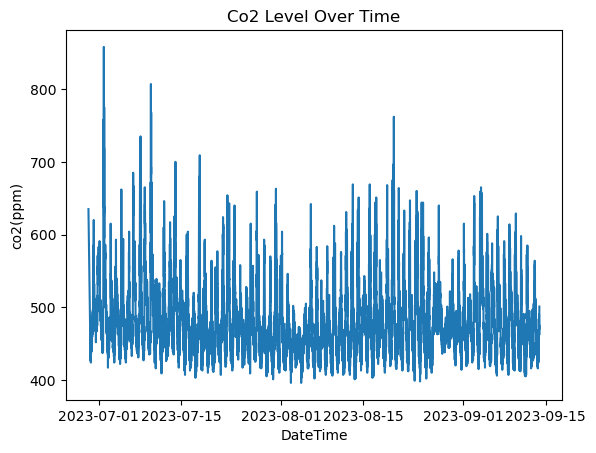

In [259]:
sns.lineplot(x='DateTime', y='co2(ppm)', data= df_enviroment)
plt.title('Co2 Level Over Time')
plt.show()

In [260]:
### but my frastrution is since the sensor is not measure value below 400 and above 5000 may be some datas are not correct 
### so let's check how many records are there actually

In [261]:
range_value = df_enviroment[(df_enviroment["co2(ppm)"] == 400) | (df_enviroment["co2(ppm)"] == 5000)]
range_value = len(range_value)

In [262]:
range_value

0

In [263]:
df_enviroment.head()

,id,DateTime,Sensor_Name(Identifier),co2(ppm),humidity(%RH),barometric_pressure(hPa),Temperature [°C],hour,day,month,year
0,31938,2023-06-29 06:14:46.484,EM500 Co2,635,61.0,1010.7,24.5,6,29,6,2023
1,32234,2023-06-29 13:02:29.456,EM500 Co2,472,39.5,1010.9,41.2,13,29,6,2023
2,32243,2023-06-29 13:11:48.221,EM500 Co2,467,46.0,1010.8,40.2,13,29,6,2023
3,32254,2023-06-29 13:21:48.191,EM500 Co2,463,38.0,1010.6,39.7,13,29,6,2023
4,32264,2023-06-29 13:31:48.203,EM500 Co2,436,35.0,1010.6,39.4,13,29,6,2023


In [264]:
range_values = df_enviroment[(df_enviroment['co2(ppm)'] == 400) | (df_enviroment['co2(ppm)'] == 5000)]
range_values

,id,DateTime,Sensor_Name(Identifier),co2(ppm),humidity(%RH),barometric_pressure(hPa),Temperature [°C],hour,day,month,year


In [265]:
### the good news is we don't have such kinds of value 400 or 5000 so let's go to the visualizatin

In [266]:
import matplotlib.dates as mdates

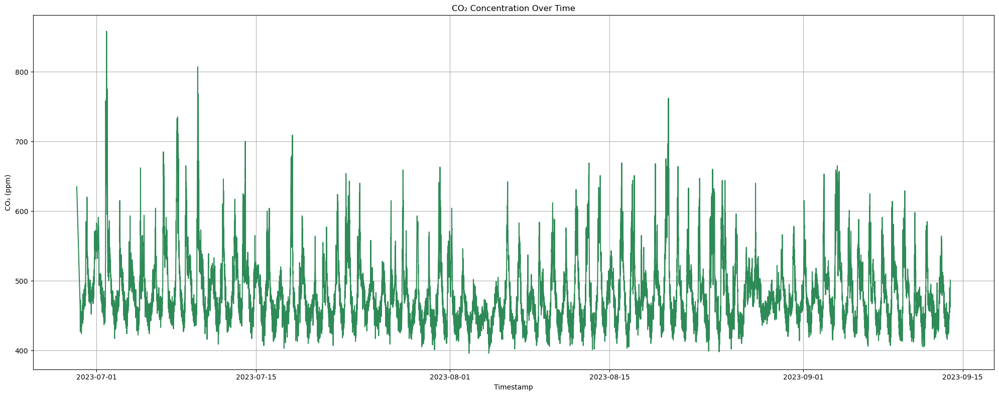

In [267]:
plt.figure(figsize=(20, 8))  # Wider figure for better clarity
sns.lineplot(x='DateTime', y='co2(ppm)', data=df_enviroment, color='#2e8b57')
plt.title('CO₂ Concentration Over Time')
plt.xlabel('Timestamp')
plt.ylabel('CO₂ (ppm)')
plt.grid(True)
plt.tight_layout()
plt.show()


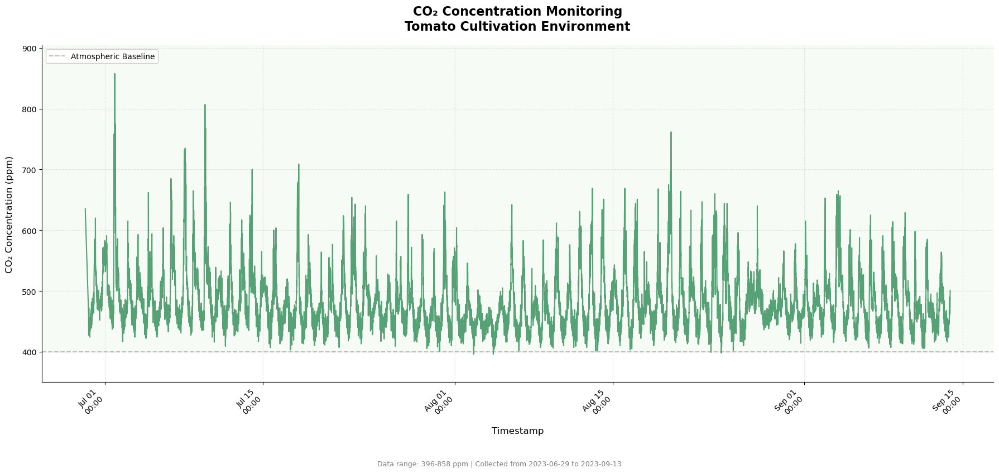

In [268]:

# Calculate dynamic y-axis limits
co2_min = df_enviroment['co2(ppm)'].min()
co2_max = df_enviroment['co2(ppm)'].max()
padding = (co2_max - co2_min) * 0.1  # 10% padding

plt.figure(figsize=(18, 8))
ax = sns.lineplot(x='DateTime', 
                 y='co2(ppm)', 
                 data=df_enviroment, 
                 color='#2e8b57',
                 linewidth=1.5,
                 alpha=0.8)

# Set dynamic y-axis limits
plt.ylim(max(350, co2_min - padding),  # Keep minimum at 350 or lower
        min(5500, co2_max + padding))  # Cap at 5500 if values exceed

# Only show reference lines that make sense for your data
if co2_max > 400:
    plt.axhline(y=400, color='gray', linestyle='--', alpha=0.5, label='Atmospheric Baseline')
if co2_max > 1000:
    plt.axhline(y=1000, color='orange', linestyle=':', alpha=0.7, label='Greenhouse Optimal')

# Title and labels
plt.title('CO₂ Concentration Monitoring\nTomato Cultivation Environment', 
          fontsize=16, pad=20, fontweight='bold')
plt.xlabel('Timestamp', fontsize=12, labelpad=10)
plt.ylabel('CO₂ Concentration (ppm)', fontsize=12, labelpad=10)

# Date formatting
ax.xaxis.set_major_locator(mdates.AutoDateLocator())
ax.xaxis.set_major_formatter(mdates.DateFormatter('%b %d\n%H:%M'))
plt.xticks(rotation=45, ha='right')

# Dynamic background coloring
if co2_max > 1000:
    ax.axhspan(400, 1000, facecolor='#e5f5e0', alpha=0.3)
    ax.axhspan(1000, co2_max + padding, facecolor='#fff7bc', alpha=0.2)
else:
    ax.axhspan(400, co2_max + padding, facecolor='#e5f5e0', alpha=0.3)

plt.grid(True, which='both', linestyle='--', alpha=0.3)
plt.legend(loc='upper left', frameon=True, framealpha=0.9)
plt.figtext(0.5, -0.05, 
           f"Data range: {co2_min:.0f}-{co2_max:.0f} ppm | Collected from {df_enviroment['DateTime'].min().date()} to {df_enviroment['DateTime'].max().date()}",
           ha="center", fontsize=9, color='gray')

sns.despine()
plt.tight_layout()
plt.show()

### Let’s Plot Temperature and Humidity Together

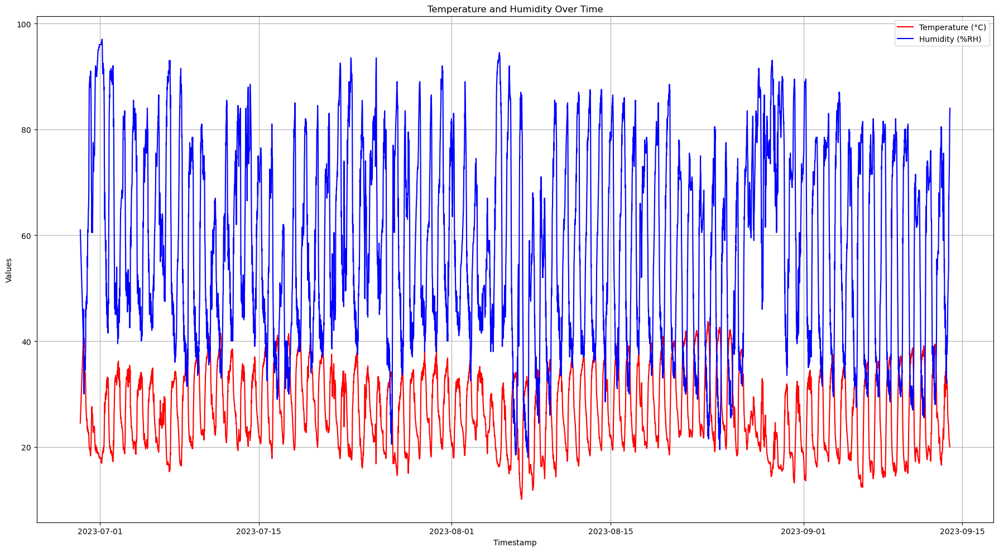

In [269]:
plt.figure(figsize=(18, 10))
sns.lineplot(x='DateTime', y='Temperature [°C]', data=df_enviroment, label='Temperature (°C)', color='red')
sns.lineplot(x='DateTime', y='humidity(%RH)', data=df_enviroment, label='Humidity (%RH)', color='blue')
plt.title('Temperature and Humidity Over Time')
plt.xlabel('Timestamp')
plt.ylabel('Values')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


In [270]:
import plotly.express as px

fig = px.line(df_enviroment, 
              x='DateTime', 
              y='co2(ppm)',
              title='CO₂ Concentration - Interactive View',
              labels={'co2(ppm)': 'CO₂ (ppm)'},
              width=1200, height=600)

# Add reference lines
fig.add_hline(y=400, line_dash="dot", line_color="gray")
fig.add_hline(y=1000, line_dash="dash", line_color="orange")

# Enable range slider and range selector
fig.update_layout(
    xaxis=dict(
        rangeselector=dict(
            buttons=list([
                dict(count=1, label="1d", step="day", stepmode="backward"),
                dict(count=7, label="1w", step="day", stepmode="backward"),
                dict(count=1, label="1m", step="month", stepmode="backward"),
                dict(step="all")
            ])
        ),
        rangeslider=dict(visible=True),
        type="date"
    )
)

fig.show()

C:\Users\SEM\anaconda3\Lib\site-packages\_plotly_utils\basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



In [271]:
import plotly.express as px

# Create interactive plot
fig = px.line(df_enviroment, 
              x='DateTime',
              y=['Temperature [°C]', 'humidity(%RH)'],
              color_discrete_map={'Temperature [°C]': 'red', 'humidity(%RH)': 'blue'},
              title='Temperature and Humidity Over Time',
              labels={'value': 'Values', 'variable': 'Measurement'},
              width=1000, height=500)

# Add range slider and buttons
fig.update_layout(
    xaxis=dict(
        rangeselector=dict(
            buttons=list([
                dict(count=1, label="1d", step="day", stepmode="backward"),
                dict(count=7, label="1w", step="day", stepmode="backward"),
                dict(step="all")
            ])
        ),
        rangeslider=dict(visible=True)
    ),
    hovermode="x unified"  # Shows both values at same timestamp
)

fig.show()

C:\Users\SEM\anaconda3\Lib\site-packages\_plotly_utils\basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



### Visualize Barometric Pressure

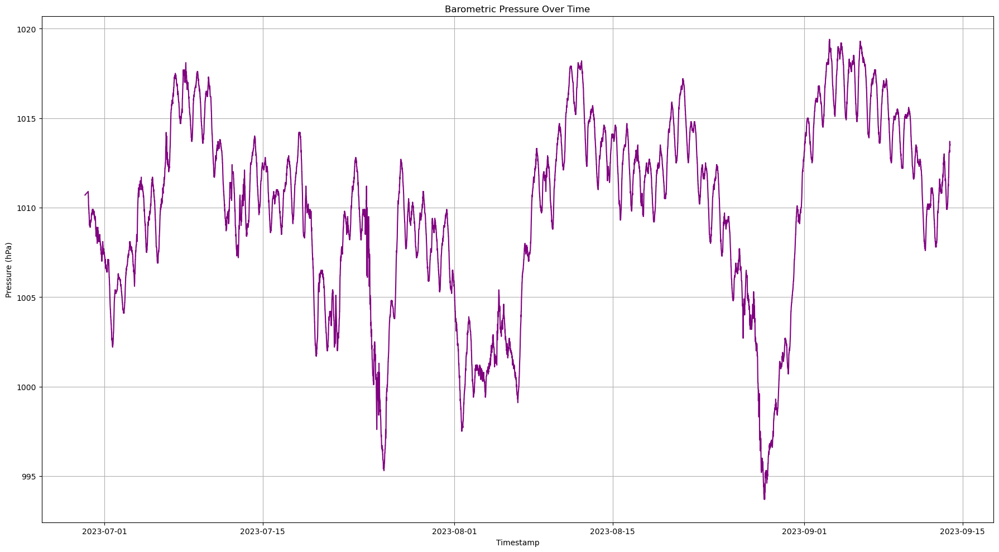

In [272]:
plt.figure(figsize=(18, 10))
sns.lineplot(x='DateTime', y='barometric_pressure(hPa)', data=df_enviroment, color='purple')
plt.title('Barometric Pressure Over Time')
plt.xlabel('Timestamp')
plt.ylabel('Pressure (hPa)')
plt.grid(True)
plt.tight_layout()
plt.show()


In [273]:
import plotly.express as px  # Import Plotly for interactive plots

# Create the interactive plot (replaces plt.figure + sns.lineplot)
fig = px.line(df_enviroment,              # Use your DataFrame
              x='DateTime',               # X-axis stays as DateTime
              y='barometric_pressure(hPa)',  # Y-axis is pressure
              color_discrete_sequence=['purple'],  # Matches your purple color
              title='Barometric Pressure Over Time',  # Same title
              labels={'barometric_pressure(hPa)': 'Pressure (hPa)'},  # Better axis label
              width=1000, height=500)     # Similar dimensions to your original

# Add interactive controls (new functionality)
fig.update_layout(
    xaxis=dict(
        rangeselector=dict(  # Adds time period buttons
            buttons=list([
                dict(count=1, label="1d", step="day", stepmode="backward"),
                dict(count=7, label="1w", step="day", stepmode="backward"),
                dict(count=1, label="1m", step="month", stepmode="backward"),
                dict(step="all", label="Reset")  # Full reset button
            ])
        ),
        rangeslider=dict(visible=True),  # Adds bottom zoom slider
        title='Timestamp'  # X-axis label
    ),
    yaxis=dict(title='Pressure (hPa)'),  # Y-axis label
    hovermode="x"  # Shows closest point when hovering
)

# Display the plot (replaces plt.show())
fig.show()

C:\Users\SEM\anaconda3\Lib\site-packages\_plotly_utils\basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



In [274]:
df_enviroment.head()

,id,DateTime,Sensor_Name(Identifier),co2(ppm),humidity(%RH),barometric_pressure(hPa),Temperature [°C],hour,day,month,year
0,31938,2023-06-29 06:14:46.484,EM500 Co2,635,61.0,1010.7,24.5,6,29,6,2023
1,32234,2023-06-29 13:02:29.456,EM500 Co2,472,39.5,1010.9,41.2,13,29,6,2023
2,32243,2023-06-29 13:11:48.221,EM500 Co2,467,46.0,1010.8,40.2,13,29,6,2023
3,32254,2023-06-29 13:21:48.191,EM500 Co2,463,38.0,1010.6,39.7,13,29,6,2023
4,32264,2023-06-29 13:31:48.203,EM500 Co2,436,35.0,1010.6,39.4,13,29,6,2023


In [275]:
print(df_enviroment.columns)


Index(['id', 'DateTime', 'Sensor_Name(Identifier)', 'co2(ppm)',
       'humidity(%RH)', 'barometric_pressure(hPa)', 'Temperature [°C]', 'hour',
       'day', 'month', 'year'],
      dtype='object')


In [276]:

df_enviroment.head()

,id,DateTime,Sensor_Name(Identifier),co2(ppm),humidity(%RH),barometric_pressure(hPa),Temperature [°C],hour,day,month,year
0,31938,2023-06-29 06:14:46.484,EM500 Co2,635,61.0,1010.7,24.5,6,29,6,2023
1,32234,2023-06-29 13:02:29.456,EM500 Co2,472,39.5,1010.9,41.2,13,29,6,2023
2,32243,2023-06-29 13:11:48.221,EM500 Co2,467,46.0,1010.8,40.2,13,29,6,2023
3,32254,2023-06-29 13:21:48.191,EM500 Co2,463,38.0,1010.6,39.7,13,29,6,2023
4,32264,2023-06-29 13:31:48.203,EM500 Co2,436,35.0,1010.6,39.4,13,29,6,2023


In [277]:
df_enviroment.drop(columns="id", inplace=True)

In [278]:
df_enviroment.head()

,DateTime,Sensor_Name(Identifier),co2(ppm),humidity(%RH),barometric_pressure(hPa),Temperature [°C],hour,day,month,year
0,2023-06-29 06:14:46.484,EM500 Co2,635,61.0,1010.7,24.5,6,29,6,2023
1,2023-06-29 13:02:29.456,EM500 Co2,472,39.5,1010.9,41.2,13,29,6,2023
2,2023-06-29 13:11:48.221,EM500 Co2,467,46.0,1010.8,40.2,13,29,6,2023
3,2023-06-29 13:21:48.191,EM500 Co2,463,38.0,1010.6,39.7,13,29,6,2023
4,2023-06-29 13:31:48.203,EM500 Co2,436,35.0,1010.6,39.4,13,29,6,2023


In [279]:
df_enviroment.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10964 entries, 0 to 10963
Data columns (total 10 columns):
 #   Column                    Non-Null Count  Dtype         
---  ------                    --------------  -----         
 0   DateTime                  10964 non-null  datetime64[ns]
 1   Sensor_Name(Identifier)   10964 non-null  object        
 2   co2(ppm)                  10964 non-null  int64         
 3   humidity(%RH)             10964 non-null  float64       
 4   barometric_pressure(hPa)  10964 non-null  float64       
 5   Temperature [°C]          10964 non-null  float64       
 6   hour                      10964 non-null  int32         
 7   day                       10964 non-null  int32         
 8   month                     10964 non-null  int32         
 9   year                      10964 non-null  int32         
dtypes: datetime64[ns](1), float64(3), int32(4), int64(1), object(1)
memory usage: 685.4+ KB


In [280]:
# See index information
print(df_enviroment.index)

RangeIndex(start=0, stop=10964, step=1)


In [281]:
df_enviroment.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10964 entries, 0 to 10963
Data columns (total 10 columns):
 #   Column                    Non-Null Count  Dtype         
---  ------                    --------------  -----         
 0   DateTime                  10964 non-null  datetime64[ns]
 1   Sensor_Name(Identifier)   10964 non-null  object        
 2   co2(ppm)                  10964 non-null  int64         
 3   humidity(%RH)             10964 non-null  float64       
 4   barometric_pressure(hPa)  10964 non-null  float64       
 5   Temperature [°C]          10964 non-null  float64       
 6   hour                      10964 non-null  int32         
 7   day                       10964 non-null  int32         
 8   month                     10964 non-null  int32         
 9   year                      10964 non-null  int32         
dtypes: datetime64[ns](1), float64(3), int32(4), int64(1), object(1)
memory usage: 685.4+ KB


In [282]:

print(df_enviroment.columns)  # Includes 'DateTime' column

Index(['DateTime', 'Sensor_Name(Identifier)', 'co2(ppm)', 'humidity(%RH)',
       'barometric_pressure(hPa)', 'Temperature [°C]', 'hour', 'day', 'month',
       'year'],
      dtype='object')


In [284]:
df_enviroment['Sensor_Name(Identifier)'].nunique()


1

In [286]:
df_enviroment.drop(columns='Sensor_Name(Identifier)', inplace=True)

In [287]:
df_enviroment.to_csv('Envirometal_sensor_data_clean_2.csv')

In [288]:
df_enviroment.head()

,DateTime,co2(ppm),humidity(%RH),barometric_pressure(hPa),Temperature [°C],hour,day,month,year
0,2023-06-29 06:14:46.484,635,61.0,1010.7,24.5,6,29,6,2023
1,2023-06-29 13:02:29.456,472,39.5,1010.9,41.2,13,29,6,2023
2,2023-06-29 13:11:48.221,467,46.0,1010.8,40.2,13,29,6,2023
3,2023-06-29 13:21:48.191,463,38.0,1010.6,39.7,13,29,6,2023
4,2023-06-29 13:31:48.203,436,35.0,1010.6,39.4,13,29,6,2023


In [294]:
df_enviroment_date_only= df_enviroment[['DateTime','co2(ppm)','humidity(%RH)','barometric_pressure(hPa)','Temperature [°C]']]

In [295]:
# 1. Make a proper copy first to avoid SettingWithCopyWarning
df_enviroment_date_only = df_enviroment[['DateTime', 'co2(ppm)', 'humidity(%RH)', 
                                        'barometric_pressure(hPa)', 'Temperature [°C]']].copy()

# 2. Convert datetime safely (handling errors)
df_enviroment_date_only['DateTime'] = pd.to_datetime(df_enviroment_date_only['DateTime'], 
                                                    errors='coerce')

# 3. Set index AFTER datetime conversion
df_enviroment_date_only = df_enviroment_date_only.set_index('DateTime')

# 4. Resample with proper handling of missing values
daily_avg = df_enviroment_date_only.resample('D').mean()

# 5. Show results
display(daily_avg.head())

,co2(ppm),humidity(%RH),barometric_pressure(hPa),Temperature [°C]
DateTime,,,,
2023-06-29,460.552239,46.074627,1009.597015,29.259701
2023-06-30,511.286713,83.891608,1008.310490,20.973427
2023-07-01,532.569444,76.062500,1005.137500,23.584028
2023-07-02,481.812500,60.954861,1005.465278,27.673611
2023-07-03,488.166667,63.961806,1007.648611,26.593056


## now let's see the plot daily trend

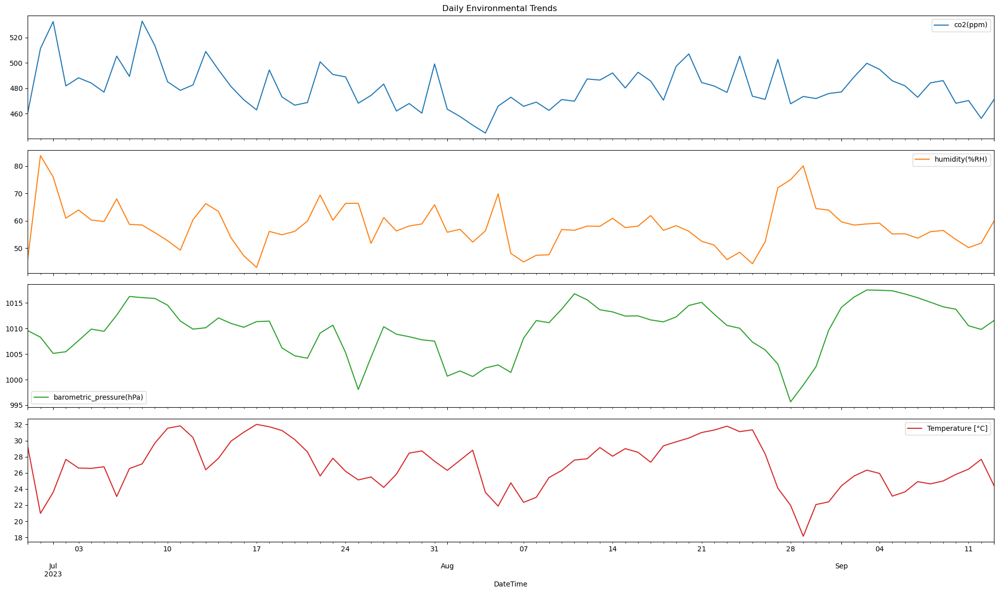

In [296]:
daily_avg.plot(subplots=True, figsize=(20, 12), title='Daily Environmental Trends')
plt.tight_layout()
plt.show()


In [297]:
from scipy import stats
import numpy as np

def detect_outliers_zscore(df, column, threshold=3):
    z_scores = np.abs(stats.zscore(df[column]))
    return df[z_scores > threshold]

# Example usage:
outliers = detect_outliers_zscore(df_enviroment_date_only, 'Temperature [°C]')
print(f"Found {len(outliers)} temperature outliers:")
display(outliers)

Found 0 temperature outliers:


,co2(ppm),humidity(%RH),barometric_pressure(hPa),Temperature [°C]
DateTime,,,,


In [298]:
def detect_outliers_iqr(df, column):
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1
    return df[(df[column] < (Q1 - 1.5*IQR)) | (df[column] > (Q3 + 1.5*IQR))]

# Example usage:
temp_outliers = detect_outliers_iqr(df_enviroment_date_only, 'Temperature [°C]')
co2_outliers = detect_outliers_iqr(df_enviroment_date_only, 'co2(ppm)')

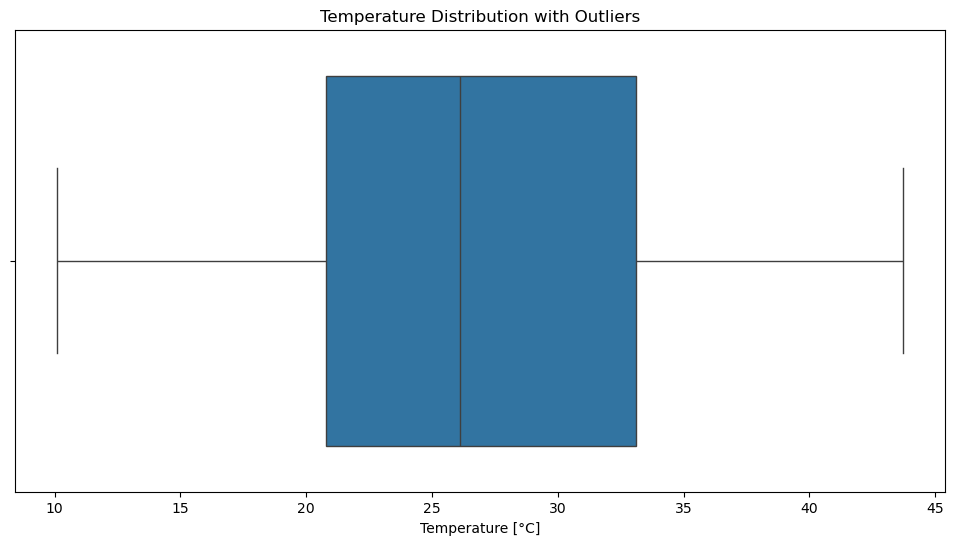

In [299]:
plt.figure(figsize=(12,6))
sns.boxplot(x=df_enviroment_date_only['Temperature [°C]'])
plt.title("Temperature Distribution with Outliers")
plt.show()

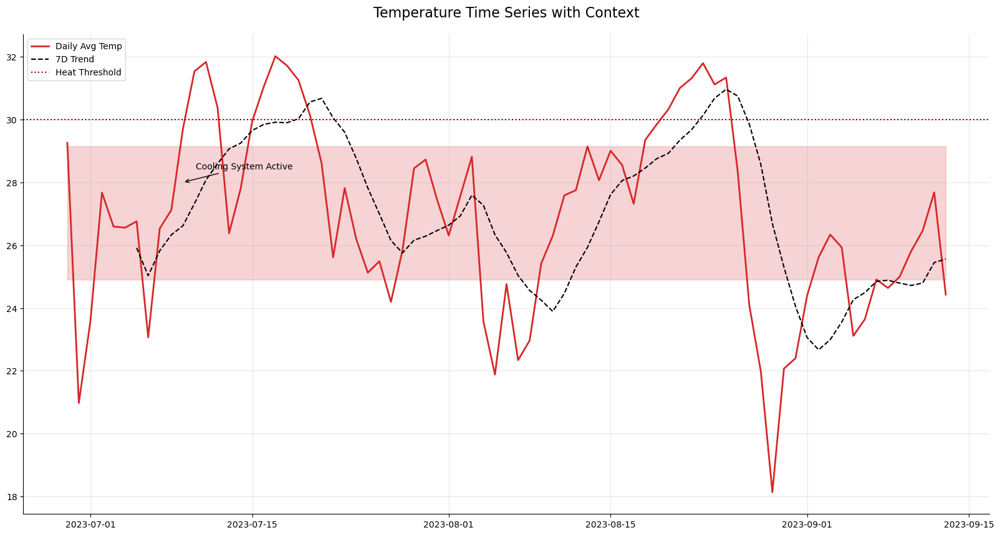

In [301]:
plt.figure(figsize=(20, 10))

# 1. Main time series
plt.plot(daily_avg.index, daily_avg['Temperature [°C]'], 
         label='Daily Avg Temp', color='tab:red', lw=2)

# 2. Trend line (7-day rolling)
plt.plot(daily_avg.index, 
         daily_avg['Temperature [°C]'].rolling(7).mean(), 
         label='7D Trend', linestyle='--', color='black')

# 3. Critical thresholds
plt.axhline(y=30, color='darkred', linestyle=':', 
            label='Heat Threshold')

# 4. Annotations for events
plt.annotate('Cooling System Active', 
             xy=(mdates.date2num(daily_avg.index[10]), 28), 
             xytext=(15, 15), textcoords='offset points',
             arrowprops=dict(arrowstyle='->'))

# 5. Uncertainty bands (IQR)
plt.fill_between(daily_avg.index,
                daily_avg['Temperature [°C]'].quantile(0.25),
                daily_avg['Temperature [°C]'].quantile(0.75),
                alpha=0.2, color='tab:red')

plt.title('Temperature Time Series with Context', pad=20, fontsize=16)
plt.legend(loc='upper left')
plt.grid(True, alpha=0.3)
sns.despine()

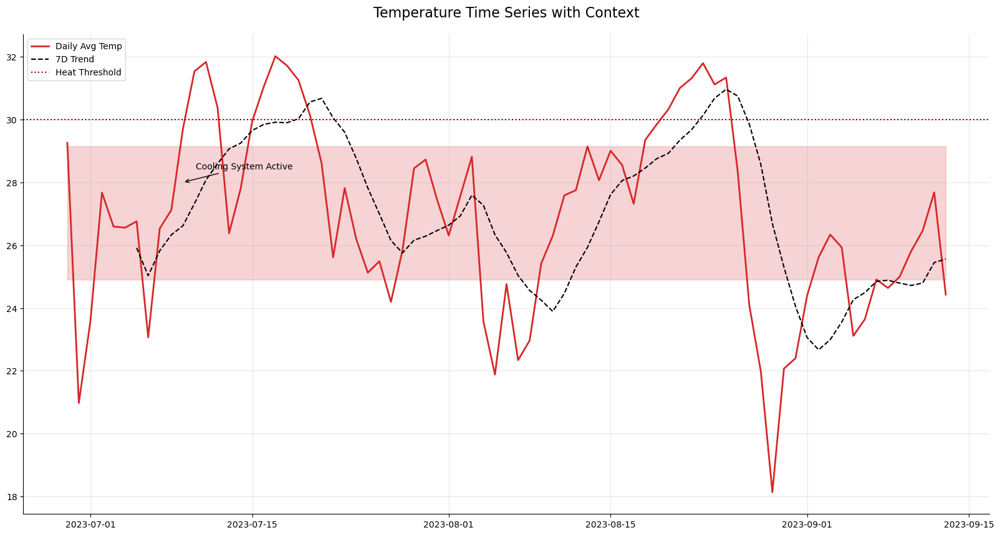

In [307]:
daily_avg

,co2(ppm),humidity(%RH),barometric_pressure(hPa),Temperature [°C]
DateTime,,,,
2023-06-29,460.552239,46.074627,1009.597015,29.259701
2023-06-30,511.286713,83.891608,1008.310490,20.973427
2023-07-01,532.569444,76.062500,1005.137500,23.584028
2023-07-02,481.812500,60.954861,1005.465278,27.673611
2023-07-03,488.166667,63.961806,1007.648611,26.593056
...,...,...,...,...
2023-09-09,485.972222,56.486111,1014.256944,24.989583
2023-09-10,468.097222,53.173611,1013.779167,25.806250
2023-09-11,470.236111,50.184028,1010.543750,26.459722


In [308]:
import plotly.express as px
fig = px.line(daily_avg.reset_index(), 
              x='DateTime', 
              y=['Temperature [°C]', 'humidity(%RH)'],
              title='Multi-Variable Time Series',
              labels={'value': 'Measurement'})
fig.update_layout(hovermode='x unified')
fig.show()

C:\Users\SEM\anaconda3\Lib\site-packages\_plotly_utils\basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



C:\Program Files\KMSpico\temp\ipykernel_10276\1500418550.py:5: UserWarning:

The figure layout has changed to tight



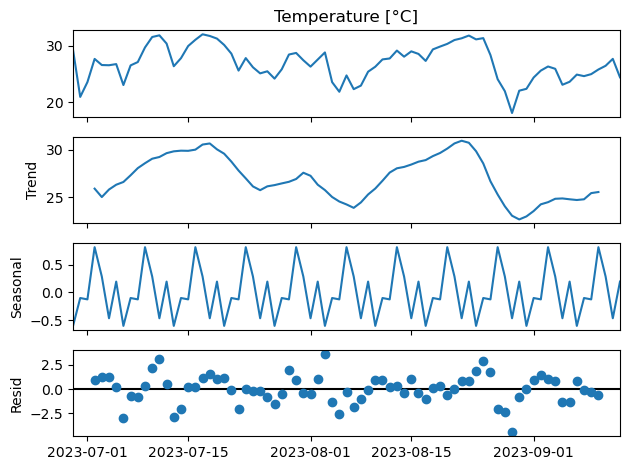

In [309]:
from statsmodels.tsa.seasonal import seasonal_decompose
result = seasonal_decompose(daily_avg['Temperature [°C]'], 
                           period=7) # Weekly seasonality
result.plot()
plt.tight_layout()